In [1]:
from IPython.display import display, HTML

display(HTML("<style>.container { width:100% !important; }</style>"))

In [2]:
!python -V

Python 3.11.2


In [3]:
import binpan
from binpan import handlers

import pandas as pd

Numba imported


In [4]:
binpan.__version__

'0.7.10'

In [5]:
btcusdt = binpan.Symbol(symbol='btcusdt',
                        tick_interval='5m',
                        time_zone='Europe/Madrid',
                        end_time='2022-03-01 02:00:00',
                        limit=100)
btcusdt.df

2023-11-14	 19:12:03     INFO get_candles_by_time_stamps -> symbol=BTCUSDT tick_interval=5m start=2022-02-28 17:40:00 end=2022-03-01 02:00:00


,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp
BTCUSDT 5m Europe/Madrid,,,,,,,,,,,,,,
2022-02-28 17:40:00+01:00,2022-02-28 17:40:00+01:00,41100.00,41271.74,41074.38,41112.22,357.21921,2022-02-28 17:44:59.999000+01:00,1.470950e+07,9010,181.48159,7.474220e+06,0,1646066400000,1646066699999
2022-02-28 17:45:00+01:00,2022-02-28 17:45:00+01:00,41114.30,41167.00,40850.61,40957.63,408.55782,2022-02-28 17:49:59.999000+01:00,1.673756e+07,11858,163.03921,6.679146e+06,0,1646066700000,1646066999999
2022-02-28 17:50:00+01:00,2022-02-28 17:50:00+01:00,40957.64,41057.01,40863.86,40970.02,245.49681,2022-02-28 17:54:59.999000+01:00,1.004923e+07,7415,125.54131,5.138570e+06,0,1646067000000,1646067299999
2022-02-28 17:55:00+01:00,2022-02-28 17:55:00+01:00,40970.02,41048.99,40962.81,41010.09,156.68212,2022-02-28 17:59:59.999000+01:00,6.425211e+06,5508,75.88644,3.111802e+06,0,1646067300000,1646067599999
2022-02-28 18:00:00+01:00,2022-02-28 18:00:00+01:00,41010.09,41093.03,40973.83,40978.93,187.15742,2022-02-28 18:04:59.999000+01:00,7.678307e+06,6438,95.66053,3.924950e+06,0,1646067600000,1646067899999
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-03-01 01:35:00+01:00,2022-03-01 01:35:00+01:00,43523.81,43545.14,43401.27,43424.01,219.27872,2022-03-01 01:39:59.999000+01:00,9.534176e+06,6122,76.40497,3.321733e+06,0,1646094900000,1646095199999
2022-03-01 01:40:00+01:00,2022-03-01 01:40:00+01:00,43424.02,43533.84,43421.97,43525.23,223.68288,2022-03-01 01:44:59.999000+01:00,9.724204e+06,4482,160.01466,6.956899e+06,0,1646095200000,1646095499999
2022-03-01 01:45:00+01:00,2022-03-01 01:45:00+01:00,43525.23,43750.00,43329.81,43351.82,485.30791,2022-03-01 01:49:59.999000+01:00,2.112750e+07,12291,266.66611,1.161137e+07,0,1646095500000,1646095799999


2023-11-14	 19:12:05     INFO New column: SMA_21


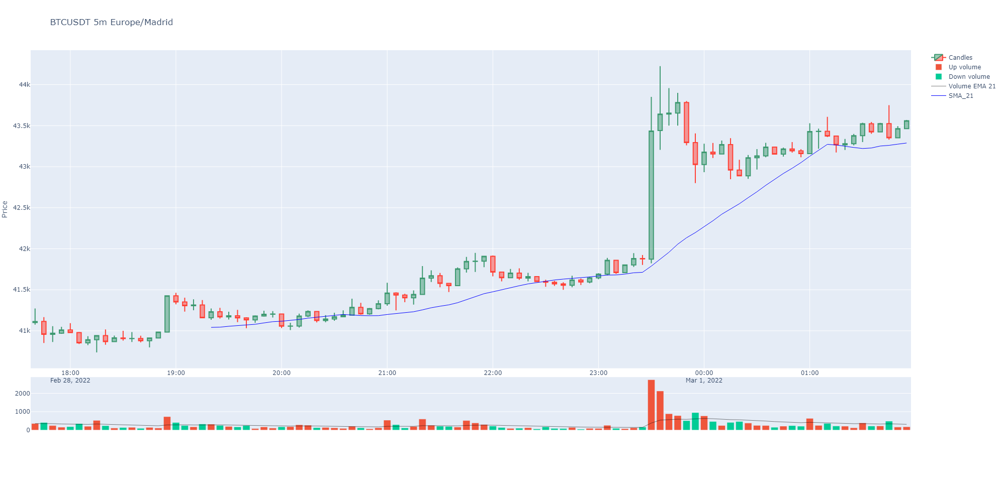

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [6]:
btcusdt.sma(21, color='blue')
btcusdt.plot()

## Volume can be ommited

2023-11-14	 19:12:06     INFO New column: SMA_12


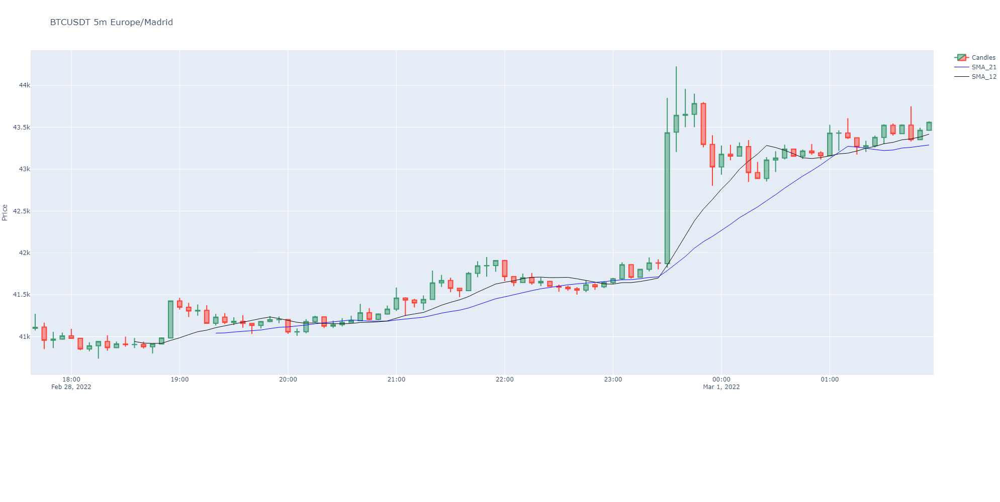

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [7]:
btcusdt.sma(12, color='black')
btcusdt.plot(volume=False)

## Autosave png:
All plots are saved automaticaly to the path referenced before the plot.

# Fixed zoom can be done by passing integer index start and end to the plot

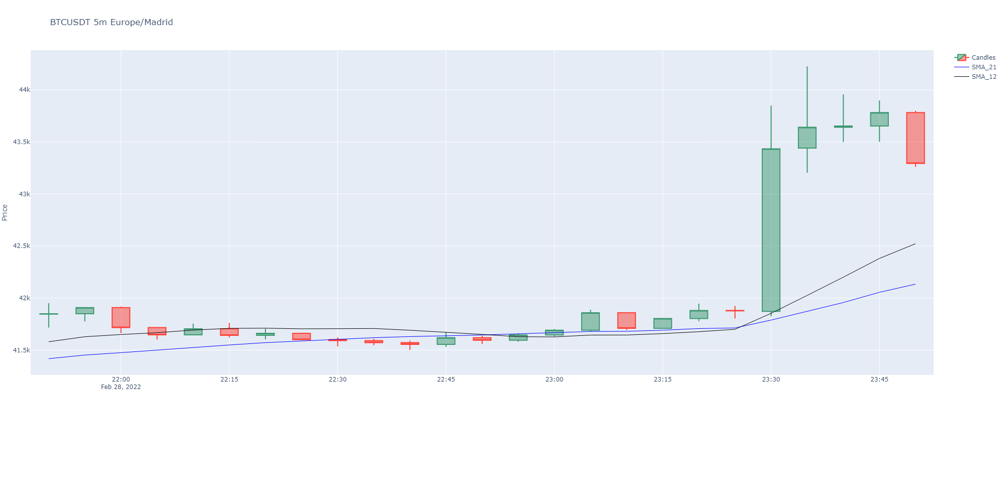

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [8]:
btcusdt.plot(volume=False, zoom_start_idx=50, zoom_end_idx=75)

# Ploting buys and sells

In [9]:
df = handlers.strategies.random_strategy(data=btcusdt.df, buys_qty=10, sells_qty=10)
df['actions'].value_counts()

actions
 1.0    10
-1.0    10
Name: count, dtype: int64

In [10]:
# get just alternating from buy to sell discarding between ones
clean_actions = handlers.tags.clean_in_out(serie=df['actions'])
clean_actions.value_counts()

 1.0    5
-1.0    5
Name: count, dtype: int64

# It's possible to insert any serie or dataframe in the Symbol instance.
It is convenient to insert rows positions in the plot. Ccolors and color fills can be added too but it can be automatically added if ommited.

In [11]:
# btcusdt.insert_indicator(source_data=clean_actions, rows=[2], colors=['brown'], suffix='_added_manually', color_fills=['rgba(12,54,34,0.5)'])

In [12]:
btcusdt.insert_indicator(source_data=clean_actions, name='random_strategy').dropna()

2023-11-14	 19:12:06     INFO New column: random_strategy


,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp,SMA_21,SMA_12,random_strategy
BTCUSDT 5m Europe/Madrid,,,,,,,,,,,,,,,,,
2022-02-28 19:55:00+01:00,2022-02-28 19:55:00+01:00,41202.22,41239.98,41161.50,41204.66,107.36465,2022-02-28 19:59:59.999000+01:00,4.423750e+06,3254,62.13003,2.559914e+06,0,1646074500000,1646074799999,41111.085238,41216.316667,-1.0
2022-02-28 21:30:00+01:00,2022-02-28 21:30:00+01:00,41670.90,41705.38,41530.52,41577.51,211.66985,2022-02-28 21:34:59.999000+01:00,8.806032e+06,5550,83.43804,3.470752e+06,0,1646080200000,1646080499999,41299.628571,41409.620000,1.0
2022-02-28 21:50:00+01:00,2022-02-28 21:50:00+01:00,41845.21,41950.00,41716.32,41849.04,388.34680,2022-02-28 21:54:59.999000+01:00,1.625013e+07,11825,202.66824,8.481218e+06,0,1646081400000,1646081699999,41417.634762,41580.180000,-1.0
2022-02-28 22:05:00+01:00,2022-02-28 22:05:00+01:00,41716.16,41721.00,41601.61,41646.99,138.22919,2022-02-28 22:09:59.999000+01:00,5.759607e+06,4546,66.98810,2.791412e+06,0,1646082300000,1646082599999,41500.004762,41667.225833,1.0
2022-02-28 23:00:00+01:00,2022-02-28 23:00:00+01:00,41645.00,41702.01,41628.99,41691.07,92.24797,2022-02-28 23:04:59.999000+01:00,3.844073e+06,3794,45.19635,1.883277e+06,0,1646085600000,1646085899999,41668.343333,41626.768333,-1.0
2022-03-01 00:30:00+01:00,2022-03-01 00:30:00+01:00,43108.98,43213.88,42965.56,43132.35,255.08115,2022-03-01 00:34:59.999000+01:00,1.098643e+07,6843,151.53244,6.525828e+06,0,1646091000000,1646091299999,42694.425238,43257.480000,1.0
2022-03-01 01:00:00+01:00,2022-03-01 01:00:00+01:00,43160.00,43529.82,43155.68,43428.83,634.06281,2022-03-01 01:04:59.999000+01:00,2.749766e+07,14677,369.84994,1.603809e+07,0,1646092800000,1646093099999,43127.220476,43158.725000,-1.0


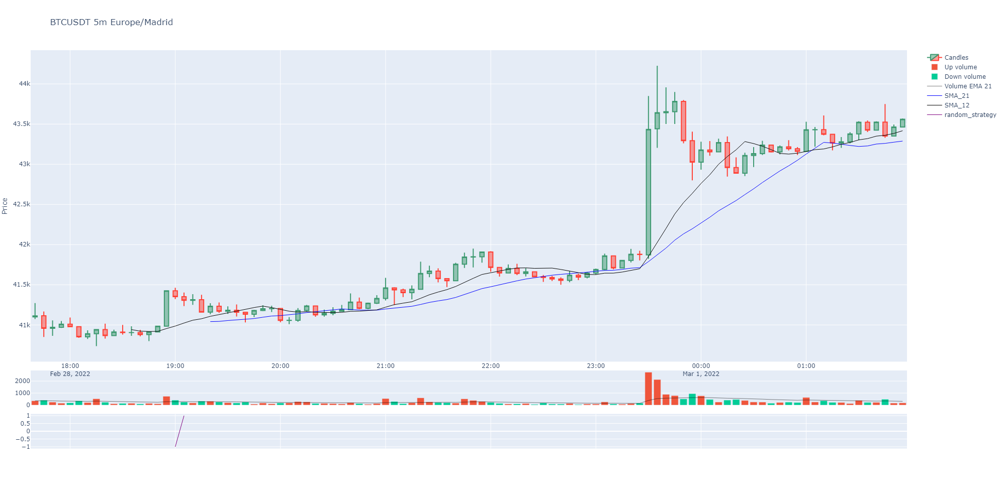

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [13]:
btcusdt.plot()

## Check plot controls generated

In [14]:
btcusdt.row_control

{'SMA_21': 1, 'SMA_12': 1, 'random_strategy': 2}

In [15]:
btcusdt.color_control

{'SMA_21': 'blue', 'SMA_12': 'black', 'random_strategy': 'purple'}

In [16]:
btcusdt.color_fill_control

{'SMA_21': None, 'SMA_12': None, 'random_strategy': None}

In [17]:
btcusdt.axis_groups

{}

## But, for actions or tags over the candles, it's better using reference to column containing the actions

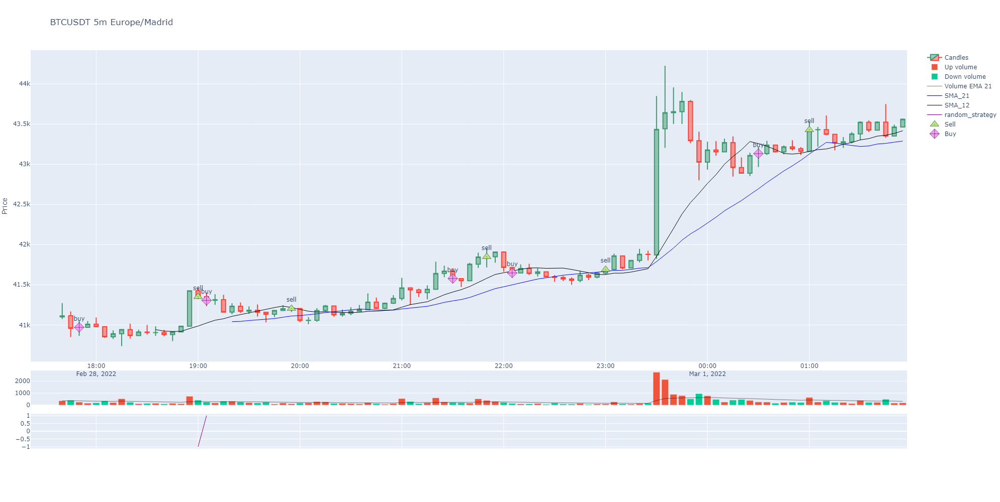

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [18]:
btcusdt.plot(actions_col='random_strategy', marker_labels={-1: 'sell', 1: 'buy'}, marker_colors={-1: 5, 1: 34}, markers={-1:205, 1:31})

## Markers can be set or leave it automatic

If actions column was created by BinPan, probably it will plot it right.

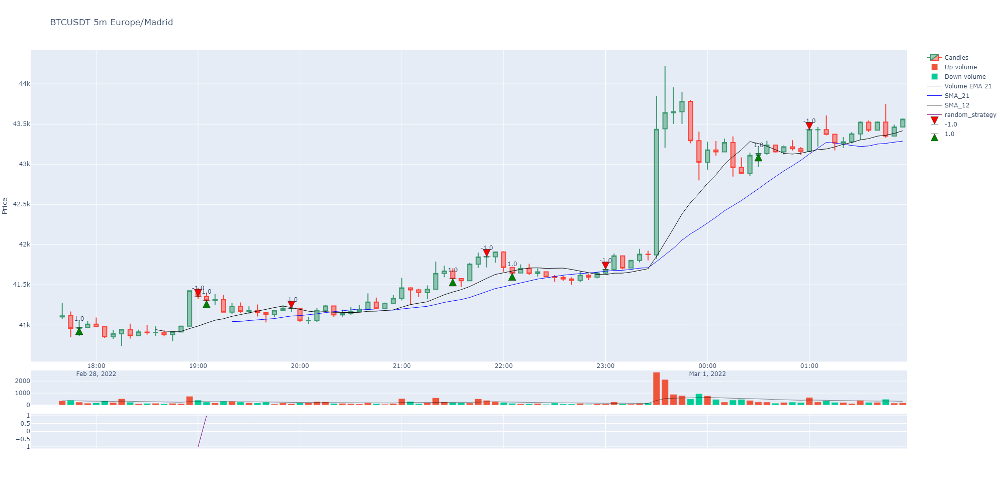

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [19]:
btcusdt.plot(actions_col='random_strategy')

# Examples with LUNCBUSD symbol

In [20]:
lunc = binpan.Symbol(symbol='luncbusd',
    tick_interval='5m',
    hours=240,
    time_zone = 'Europe/Madrid',
    closed = True)
lunc.df

2023-11-14	 19:12:07     INFO get_candles_by_time_stamps -> symbol=LUNCBUSD tick_interval=5m start=2023-11-04 19:12:07 end=2023-11-14 19:09:58
2023-11-14	 19:12:08  WARNING API response missing 1 klines (maybe not closed yet) for LUNCBUSD 2023-11-11 17:52:07 to 2023-11-14 19:09:58 expected 880 got 879
C:\Users\hanca\PycharmProjects\binpan_studio\venv3.11\Lib\site-packages\pandas\core\dtypes\cast.py:375: RuntimeWarning:

invalid value encountered in cast



,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp
LUNCBUSD 5m Europe/Madrid,,,,,,,,,,,,,,
2023-11-04 19:15:00+01:00,2023-11-04 19:15:00+01:00,0.000064,0.000064,0.000064,0.000064,9.353851e+06,2023-11-04 19:19:59.999000+01:00,600.972495,8,1.554864e+05,9.977562,0,1699121700000,1699121999999
2023-11-04 19:20:00+01:00,2023-11-04 19:20:00+01:00,0.000064,0.000064,0.000064,0.000064,1.041416e+07,2023-11-04 19:24:59.999000+01:00,667.368590,30,1.921597e+06,123.208112,0,1699122000000,1699122299999
2023-11-04 19:25:00+01:00,2023-11-04 19:25:00+01:00,0.000064,0.000064,0.000064,0.000064,7.724962e+06,2023-11-04 19:29:59.999000+01:00,495.216312,8,6.189672e+05,39.675799,0,1699122300000,1699122599999
2023-11-04 19:30:00+01:00,2023-11-04 19:30:00+01:00,0.000064,0.000064,0.000064,0.000064,8.776003e+06,2023-11-04 19:34:59.999000+01:00,562.705627,7,1.419551e+06,91.130686,0,1699122600000,1699122899999
2023-11-04 19:35:00+01:00,2023-11-04 19:35:00+01:00,0.000064,0.000064,0.000064,0.000064,2.718855e+07,2023-11-04 19:39:59.999000+01:00,1746.443234,40,2.439486e+07,1567.005836,0,1699122900000,1699123199999
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-14 18:45:00+01:00,2023-11-14 18:45:00+01:00,0.000079,0.000079,0.000079,0.000079,3.129216e+07,2023-11-14 18:49:59.999000+01:00,2467.801469,28,2.577065e+07,2032.486071,0,1699983900000,1699984199999
2023-11-14 18:50:00+01:00,2023-11-14 18:50:00+01:00,0.000079,0.000079,0.000079,0.000079,4.648059e+07,2023-11-14 18:54:59.999000+01:00,3656.047386,29,6.719021e+06,528.247810,0,1699984200000,1699984499999
2023-11-14 18:55:00+01:00,2023-11-14 18:55:00+01:00,0.000079,0.000079,0.000078,0.000078,1.459468e+08,2023-11-14 18:59:59.999000+01:00,11458.877489,47,2.165500e+07,1700.398397,0,1699984500000,1699984799999


In [21]:
lunc.supertrend()

2023-11-14	 19:12:08     INFO New column: SUPERT_10_3.0
2023-11-14	 19:12:08     INFO New column: SUPERTd_10_3.0
2023-11-14	 19:12:08     INFO New column: SUPERTl_10_3.0
2023-11-14	 19:12:08     INFO New column: SUPERTs_10_3.0


,SUPERT_10_3.0,SUPERTd_10_3.0,SUPERTl_10_3.0,SUPERTs_10_3.0
LUNCBUSD 5m Europe/Madrid,,,,
2023-11-04 19:15:00+01:00,NaN,1,NaN,NaN
2023-11-04 19:20:00+01:00,NaN,1,NaN,NaN
2023-11-04 19:25:00+01:00,NaN,1,NaN,NaN
2023-11-04 19:30:00+01:00,NaN,1,NaN,NaN
2023-11-04 19:35:00+01:00,NaN,1,NaN,NaN
...,...,...,...,...
2023-11-14 18:45:00+01:00,0.000080,-1,NaN,0.000080
2023-11-14 18:50:00+01:00,0.000080,-1,NaN,0.000080
2023-11-14 18:55:00+01:00,0.000079,-1,NaN,0.000079


## Horizontal lines can be added to the plot for support or resistance levels

In [22]:
# added arbitrary horizontal lines
hline = pd.Series(index=lunc.df.index, data=lunc.df['Close'].mean())
hline

LUNCBUSD 5m Europe/Madrid
2023-11-04 19:15:00+01:00    0.000074
2023-11-04 19:20:00+01:00    0.000074
2023-11-04 19:25:00+01:00    0.000074
2023-11-04 19:30:00+01:00    0.000074
2023-11-04 19:35:00+01:00    0.000074
                               ...   
2023-11-14 18:45:00+01:00    0.000074
2023-11-14 18:50:00+01:00    0.000074
2023-11-14 18:55:00+01:00    0.000074
2023-11-14 19:00:00+01:00    0.000074
2023-11-14 19:05:00+01:00    0.000074
Length: 2879, dtype: float64

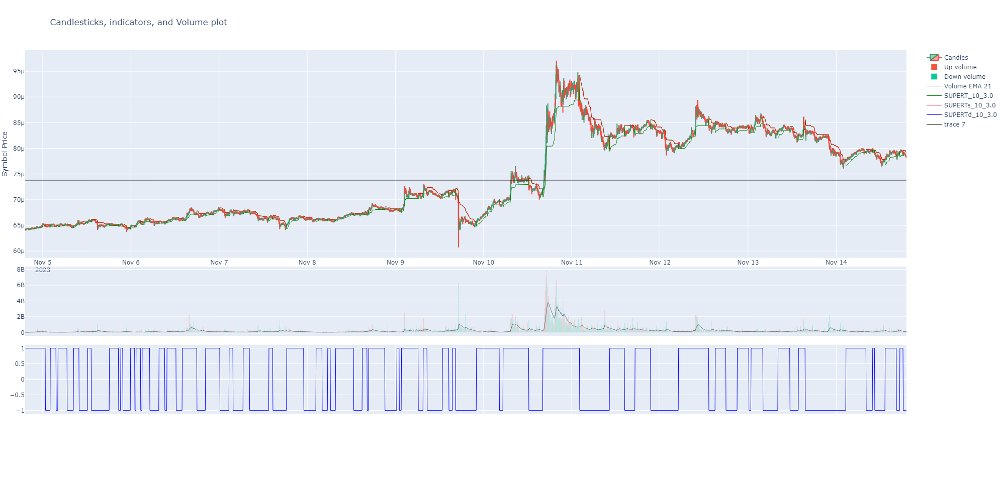

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [23]:
# manual plotting needed using candles_ta method
handlers.plotting.candles_ta(data = lunc.df,
                             indicators_series=[lunc.df['SUPERT_10_3.0'], lunc.df['SUPERTs_10_3.0'], lunc.df['SUPERTd_10_3.0'], hline], # added arbitrary horizontal lines
                             rows_pos=[1,1, 2,1],
                             indicators_colors=['green', 'red', 'blue', "black"])  

### Change indicator color


In [24]:
lunc.set_plot_color(indicator_column='SUPERTd_10_3.0', color='black')
lunc.set_plot_color(indicator_column='SUPERTl_10_3.0', color='orange')
lunc.set_plot_color(indicator_column='SUPERTs_10_3.0', color='skyblue')
lunc.set_plot_color()

{'SUPERT_10_3.0': 'brown',
 'SUPERTd_10_3.0': 'black',
 'SUPERTl_10_3.0': 'orange',
 'SUPERTs_10_3.0': 'skyblue'}

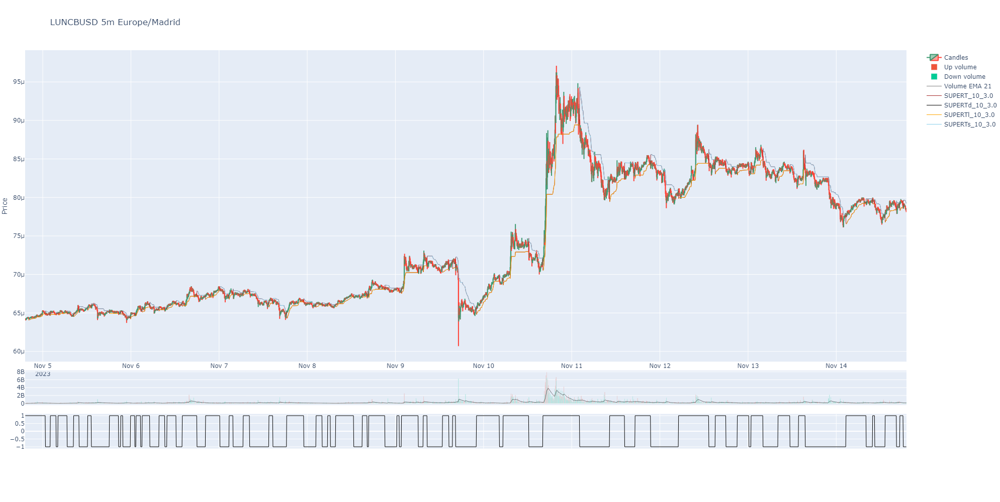

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [25]:
lunc.plot()

# Plotting with trades

In [26]:
# just last few minutes for faster example
lunc.get_agg_trades(minutes=240)

Requesting aggregated trades between 2023-11-14 15:12:12 and 2023-11-14 19:05:00


2023-11-14	 19:12:12     INFO Requests API for aggregated trades searching STARTIME LUNCBUSD: 2 current_first_trade:80341309
2023-11-14	 19:12:12     INFO Requests API for aggregated trades searching STARTIME LUNCBUSD: 3 current_first_trade:80340309


,Aggregate tradeId,Price,Quantity,First tradeId,Last tradeId,Date,Timestamp,Buyer was maker,Best price match
LUNCBUSD Europe/Madrid,,,,,,,,,
0,80339436,0.000079,5472669.08,111201183,111201183,2023-11-14 15:12:28+01:00,1699971148390,True,True
1,80339437,0.000079,914430.87,111201184,111201184,2023-11-14 15:12:28+01:00,1699971148392,False,True
2,80339438,0.000079,5199536.60,111201185,111201185,2023-11-14 15:13:28+01:00,1699971208052,False,True
3,80339439,0.000079,725111.47,111201186,111201186,2023-11-14 15:15:37+01:00,1699971337934,False,True
4,80339440,0.000079,3789553.46,111201187,111201187,2023-11-14 15:15:37+01:00,1699971337934,False,True
...,...,...,...,...,...,...,...,...,...
2725,80342161,0.000079,1122389.43,111204228,111204229,2023-11-14 19:04:27+01:00,1699985067484,False,True
2726,80342162,0.000079,523022.58,111204230,111204230,2023-11-14 19:04:36+01:00,1699985076504,True,True
2727,80342163,0.000079,1272426.51,111204231,111204231,2023-11-14 19:04:36+01:00,1699985076508,True,True


## Directly from class method

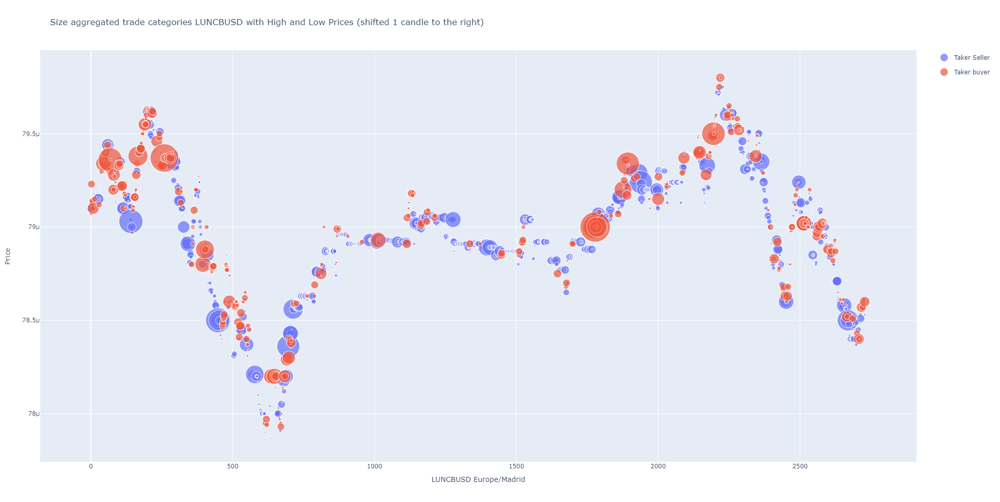

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [27]:
lunc.plot_agg_trades_size()

### Or using plot submodule

Hope this graph can be usefull in detecting whales operating at some level in big sized trades.

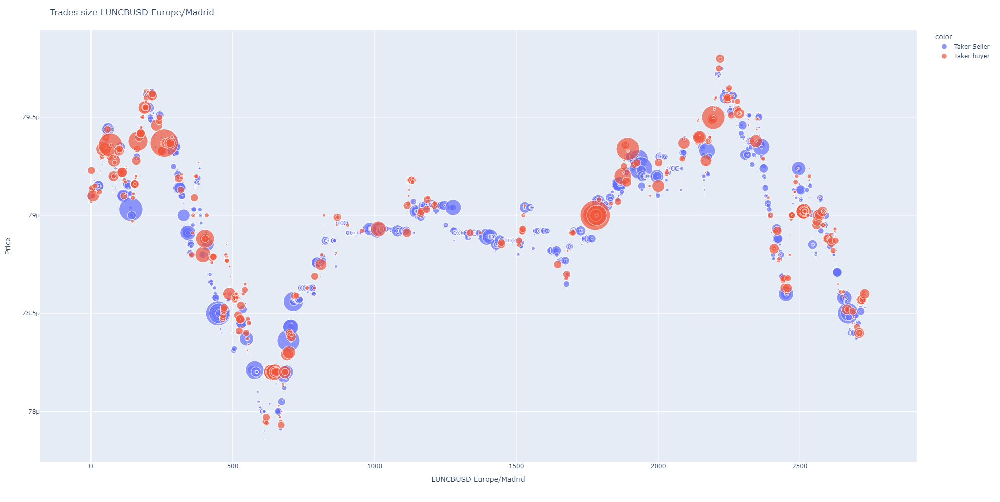

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [28]:
handlers.plotting.plot_trades(data = lunc.agg_trades,logarithmic=False)

## Support and resistance levels from trades with auto KMeans

In [29]:
# lunc.get_atomic_trades()

In [30]:
# in this case, klines are used for the kmeans stacking
sup, res = lunc.support_resistance(from_aggregated=False, from_atomic=False, max_clusters=5, by_quantity=False)
sup, res

2023-11-14	 19:12:15     INFO Updating support_resistance levels for LUNCBUSD from klines


Clustering data...


([6.638421432871765e-05,
  7.263846846846844e-05,
  7.985281447443998e-05,
  8.451432360097323e-05,
  9.190485976542587e-05],
 [])

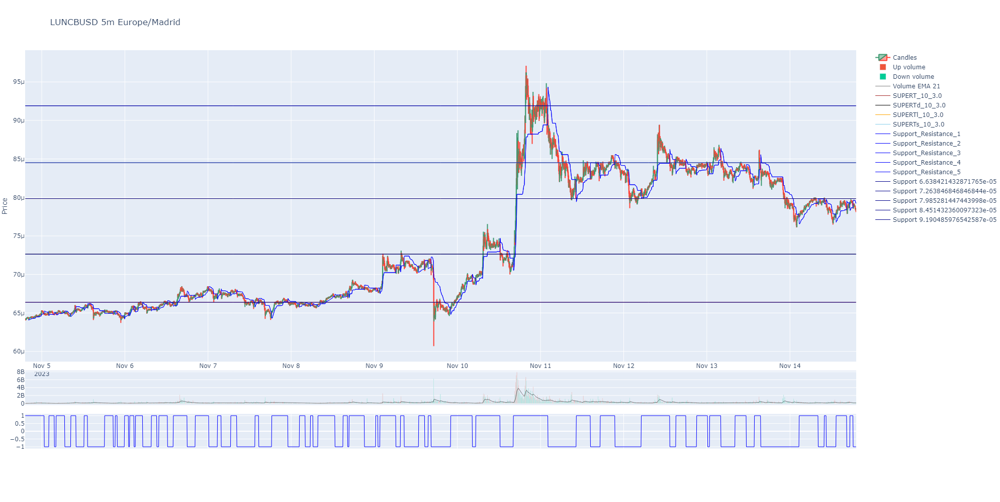

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [31]:
lunc.plot(support_lines=sup, resistance_lines=res)

### What sizes are most common
It can be scaled in a logarithmic scale optionally.

C:\Users\hanca\PycharmProjects\binpan_studio\handlers\plotting.py:1150: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



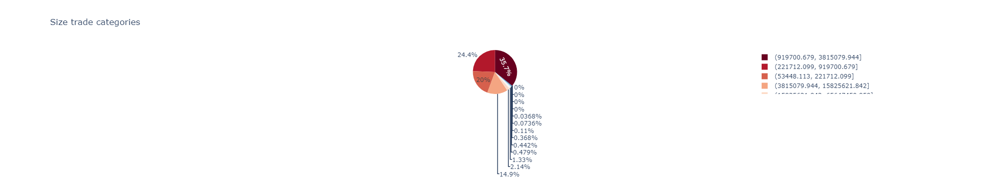

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [32]:
handlers.plotting.plot_pie(serie = lunc.agg_trades['Quantity'], logarithmic=True)

C:\Users\hanca\PycharmProjects\binpan_studio\handlers\plotting.py:1150: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



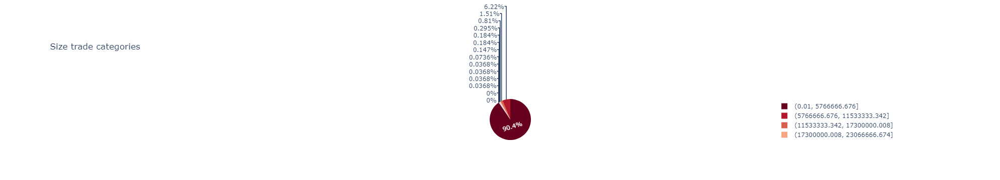

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [33]:
# Not logarithmic scale
handlers.plotting.plot_pie(serie = lunc.agg_trades['Quantity'], logarithmic=False)

### Checking levels most traded can be shown with scatter plot on trades.

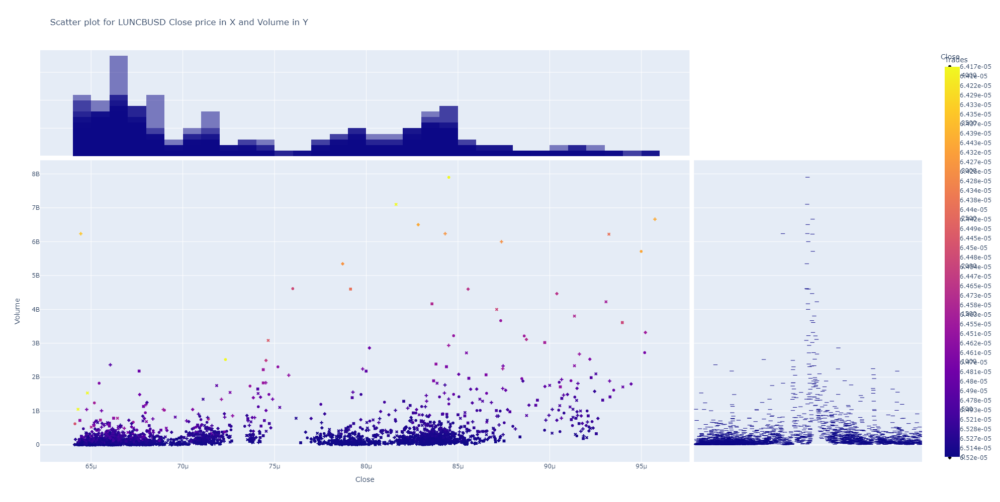

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [34]:
handlers.plotting.plot_scatter(df = lunc.df,
                                      x_col='Close',
                                      y_col='Volume',
                                      color='Trades',
                                      symbol='Close',
                                      title='Scatter plot for LUNCBUSD Close price in X and Volume in Y'
                                     )

### Levels showing more rejection can be done checking High and Close differences each price level.

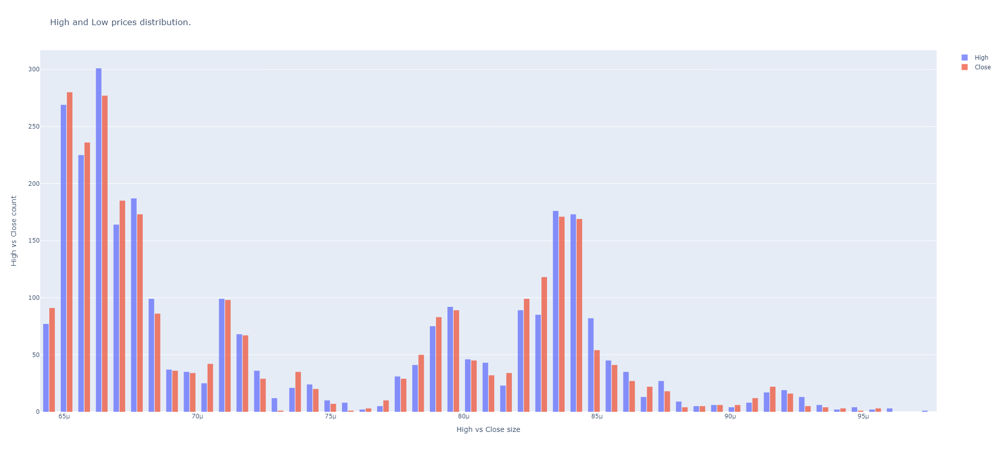

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [35]:
handlers.plotting.plot_hists_vs(x0=lunc.df['High'],
                                      x1=lunc.df['Close'],
                                      bins=50,
                                      hist_funct='count',
                                      title='High and Low prices distribution.')

# New data and more indicator plots tweaking
Are fully automated, but can be tweaked.

In [36]:
ethbtc = binpan.Symbol(symbol='ethbtc', tick_interval='1h', limit=100)
ethbtc.supertrend()
ethbtc.rsi(14)
ethbtc.df

2023-11-14	 19:12:32     INFO get_candles_by_time_stamps -> symbol=ETHBTC tick_interval=1h start=2023-11-10 15:12:32 end=2023-11-14 18:59:58
2023-11-14	 19:12:33  WARNING API response missing 1 klines (maybe not closed yet) for ETHBTC 2023-11-10 15:12:32 to 2023-11-14 18:59:58 expected 100 got 99
2023-11-14	 19:12:33     INFO New column: SUPERT_10_3.0
2023-11-14	 19:12:33     INFO New column: SUPERTd_10_3.0
2023-11-14	 19:12:33     INFO New column: SUPERTl_10_3.0
2023-11-14	 19:12:33     INFO New column: SUPERTs_10_3.0
2023-11-14	 19:12:33     INFO New column: RSI_14


,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp,SUPERT_10_3.0,SUPERTd_10_3.0,SUPERTl_10_3.0,SUPERTs_10_3.0,RSI_14
ETHBTC 1h Europe/Madrid,,,,,,,,,,,,,,,,,,,
2023-11-10 16:00:00+01:00,2023-11-10 16:00:00+01:00,0.05612,0.05651,0.05609,0.05636,3992.6136,2023-11-10 16:59:59.999000+01:00,224.900493,4286,1523.5930,85.819319,0,1699628400000,1699631999999,NaN,1,NaN,NaN,NaN
2023-11-10 17:00:00+01:00,2023-11-10 17:00:00+01:00,0.05636,0.05638,0.05606,0.05607,3282.5571,2023-11-10 17:59:59.999000+01:00,184.539988,4389,1416.6785,79.634450,0,1699632000000,1699635599999,NaN,1,NaN,NaN,NaN
2023-11-10 18:00:00+01:00,2023-11-10 18:00:00+01:00,0.05607,0.05635,0.05606,0.05634,1448.0598,2023-11-10 18:59:59.999000+01:00,81.350127,2164,738.0880,41.463078,0,1699635600000,1699639199999,NaN,1,NaN,NaN,NaN
2023-11-10 19:00:00+01:00,2023-11-10 19:00:00+01:00,0.05635,0.05644,0.05617,0.05623,1176.3750,2023-11-10 19:59:59.999000+01:00,66.268767,2135,495.3935,27.911693,0,1699639200000,1699642799999,NaN,1,NaN,NaN,NaN
2023-11-10 20:00:00+01:00,2023-11-10 20:00:00+01:00,0.05624,0.05651,0.05602,0.05609,4596.1597,2023-11-10 20:59:59.999000+01:00,258.179710,5442,3387.9731,190.383378,0,1699642800000,1699646399999,NaN,1,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-14 14:00:00+01:00,2023-11-14 14:00:00+01:00,0.05588,0.05606,0.05584,0.05597,1989.9313,2023-11-14 14:59:59.999000+01:00,111.341993,3574,1111.3302,62.189028,0,1699966800000,1699970399999,0.055888,1,0.055888,NaN,45.367473
2023-11-14 15:00:00+01:00,2023-11-14 15:00:00+01:00,0.05597,0.05606,0.05588,0.05603,955.4942,2023-11-14 15:59:59.999000+01:00,53.483501,2080,465.6046,26.064566,0,1699970400000,1699973999999,0.055888,1,0.055888,NaN,47.425732
2023-11-14 16:00:00+01:00,2023-11-14 16:00:00+01:00,0.05604,0.05647,0.05589,0.05638,3152.8075,2023-11-14 16:59:59.999000+01:00,177.072417,5630,1544.4571,86.722055,0,1699974000000,1699977599999,0.055888,1,0.055888,NaN,57.487360


### By default many indicator are not fillng with color along y-axis.

In [37]:
ethbtc.color_fill_control

{'SUPERT_10_3.0': None,
 'SUPERTd_10_3.0': None,
 'SUPERTl_10_3.0': None,
 'SUPERTs_10_3.0': None,
 'RSI_14': None}

In [38]:
ethbtc.row_control

{'SUPERT_10_3.0': 1,
 'SUPERTd_10_3.0': 2,
 'SUPERTl_10_3.0': 1,
 'SUPERTs_10_3.0': 1,
 'RSI_14': 3}

In [39]:
# add zero line
zero = pd.Series(index=ethbtc.df.index, data=0)
ethbtc.insert_indicator(source_data=zero, plotting_row=ethbtc.row_control['RSI_14'], name="zero", no_overlapped_plot_rows=False, color="black")

2023-11-14	 19:12:33     INFO New column: zero


,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp,SUPERT_10_3.0,SUPERTd_10_3.0,SUPERTl_10_3.0,SUPERTs_10_3.0,RSI_14,zero
ETHBTC 1h Europe/Madrid,,,,,,,,,,,,,,,,,,,,
2023-11-10 16:00:00+01:00,2023-11-10 16:00:00+01:00,0.05612,0.05651,0.05609,0.05636,3992.6136,2023-11-10 16:59:59.999000+01:00,224.900493,4286,1523.5930,85.819319,0,1699628400000,1699631999999,NaN,1,NaN,NaN,NaN,0
2023-11-10 17:00:00+01:00,2023-11-10 17:00:00+01:00,0.05636,0.05638,0.05606,0.05607,3282.5571,2023-11-10 17:59:59.999000+01:00,184.539988,4389,1416.6785,79.634450,0,1699632000000,1699635599999,NaN,1,NaN,NaN,NaN,0
2023-11-10 18:00:00+01:00,2023-11-10 18:00:00+01:00,0.05607,0.05635,0.05606,0.05634,1448.0598,2023-11-10 18:59:59.999000+01:00,81.350127,2164,738.0880,41.463078,0,1699635600000,1699639199999,NaN,1,NaN,NaN,NaN,0
2023-11-10 19:00:00+01:00,2023-11-10 19:00:00+01:00,0.05635,0.05644,0.05617,0.05623,1176.3750,2023-11-10 19:59:59.999000+01:00,66.268767,2135,495.3935,27.911693,0,1699639200000,1699642799999,NaN,1,NaN,NaN,NaN,0
2023-11-10 20:00:00+01:00,2023-11-10 20:00:00+01:00,0.05624,0.05651,0.05602,0.05609,4596.1597,2023-11-10 20:59:59.999000+01:00,258.179710,5442,3387.9731,190.383378,0,1699642800000,1699646399999,NaN,1,NaN,NaN,NaN,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-14 14:00:00+01:00,2023-11-14 14:00:00+01:00,0.05588,0.05606,0.05584,0.05597,1989.9313,2023-11-14 14:59:59.999000+01:00,111.341993,3574,1111.3302,62.189028,0,1699966800000,1699970399999,0.055888,1,0.055888,NaN,45.367473,0
2023-11-14 15:00:00+01:00,2023-11-14 15:00:00+01:00,0.05597,0.05606,0.05588,0.05603,955.4942,2023-11-14 15:59:59.999000+01:00,53.483501,2080,465.6046,26.064566,0,1699970400000,1699973999999,0.055888,1,0.055888,NaN,47.425732,0
2023-11-14 16:00:00+01:00,2023-11-14 16:00:00+01:00,0.05604,0.05647,0.05589,0.05638,3152.8075,2023-11-14 16:59:59.999000+01:00,177.072417,5630,1544.4571,86.722055,0,1699974000000,1699977599999,0.055888,1,0.055888,NaN,57.487360,0


In [40]:
ethbtc.color_control

{'SUPERT_10_3.0': 'brown',
 'SUPERTd_10_3.0': 'blue',
 'SUPERTl_10_3.0': 'green',
 'SUPERTs_10_3.0': 'red',
 'RSI_14': 'orange',
 'zero': 'black'}

In [41]:
ethbtc.row_control

{'SUPERT_10_3.0': 1,
 'SUPERTd_10_3.0': 2,
 'SUPERTl_10_3.0': 1,
 'SUPERTs_10_3.0': 1,
 'RSI_14': 3,
 'zero': 3}

In [42]:
# need a zero line to polot fills, demo will be tested or not
ethbtc.set_plot_color_fill(indicator_column='RSI_14', color_fill='rgba(43,54,3,0.5)')

{'SUPERT_10_3.0': None,
 'SUPERTd_10_3.0': None,
 'SUPERTl_10_3.0': None,
 'SUPERTs_10_3.0': None,
 'RSI_14': 'rgba(43,54,3,0.5)',
 'zero': None}

In [43]:
ethbtc.set_plot_filled_mode(indicator_column="RSI_14", fill_mode="tozeroy")

{'RSI_14': 'tozeroy'}

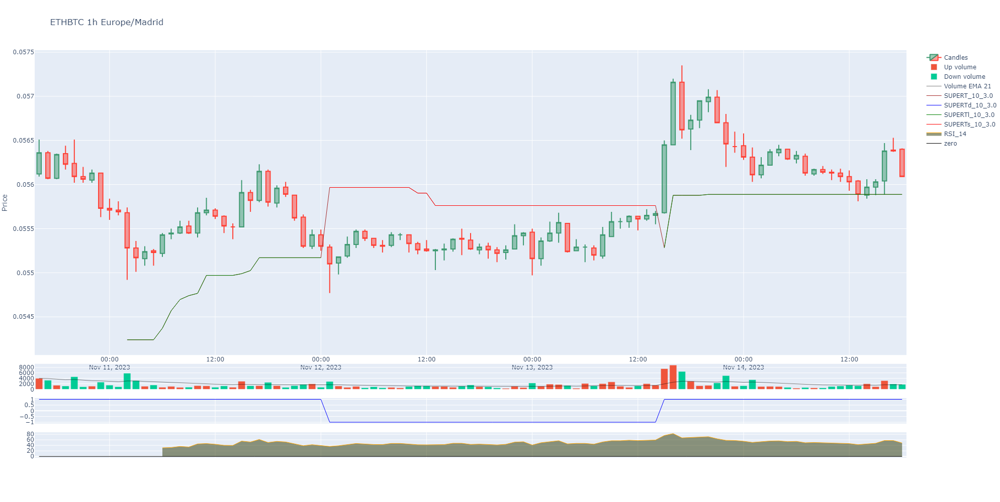

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [44]:
ethbtc.plot()

### MACD will fill histogram automatically

In [45]:
ethbtc.macd()

2023-11-14	 19:12:34     INFO New column: zeros
2023-11-14	 19:12:34     INFO New column: MACD_12_26_9
2023-11-14	 19:12:34     INFO New column: MACDh_12_26_9
2023-11-14	 19:12:34     INFO New column: MACDs_12_26_9


,zeros,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9
ETHBTC 1h Europe/Madrid,,,,
2023-11-10 16:00:00+01:00,0.0,NaN,NaN,NaN
2023-11-10 17:00:00+01:00,0.0,NaN,NaN,NaN
2023-11-10 18:00:00+01:00,0.0,NaN,NaN,NaN
2023-11-10 19:00:00+01:00,0.0,NaN,NaN,NaN
2023-11-10 20:00:00+01:00,0.0,NaN,NaN,NaN
...,...,...,...,...
2023-11-14 14:00:00+01:00,0.0,6.373518e-07,-0.000077,0.000078
2023-11-14 15:00:00+01:00,0.0,-6.391489e-06,-0.000067,0.000061
2023-11-14 16:00:00+01:00,0.0,1.609465e-05,-0.000036,0.000052


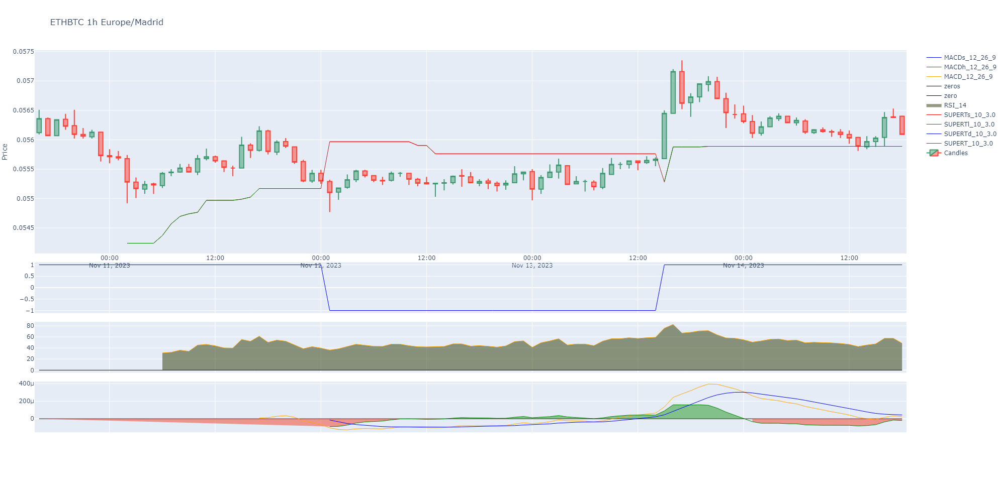

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [46]:
ethbtc.plot(candles_ta_height_ratio=0.5, volume=False)

### Colors can be horribly changed

In [47]:
ethbtc.set_plot_color(indicator_column='RSI_14', color='black')

{'SUPERT_10_3.0': 'brown',
 'SUPERTd_10_3.0': 'blue',
 'SUPERTl_10_3.0': 'green',
 'SUPERTs_10_3.0': 'red',
 'RSI_14': 'black',
 'zero': 'black',
 'zeros': 'black',
 'MACD_12_26_9': 'orange',
 'MACDh_12_26_9': 'green',
 'MACDs_12_26_9': 'blue'}

In [48]:
ethbtc.set_plot_color_fill(indicator_column='RSI_14', color_fill='red')

{'SUPERT_10_3.0': None,
 'SUPERTd_10_3.0': None,
 'SUPERTl_10_3.0': None,
 'SUPERTs_10_3.0': None,
 'RSI_14': 'red',
 'zero': None,
 'zeros': None,
 'MACD_12_26_9': None,
 'MACDs_12_26_9': None}

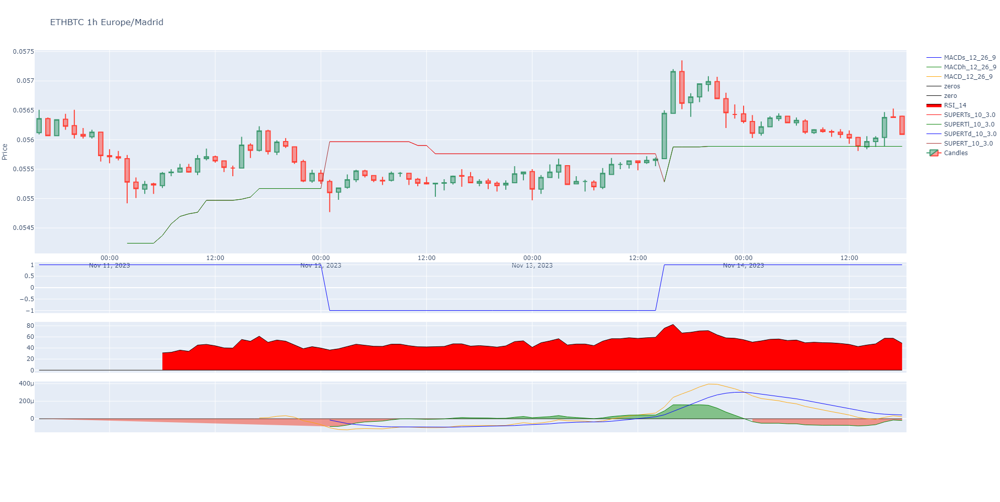

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [49]:
ethbtc.plot(candles_ta_height_ratio=0.5, volume=False)

   # Plot orderbook

In [50]:
btcusdt.get_orderbook()

,Price,Quantity,Side
BTCUSDT updateId:40353329917,,,
0,36514.00,0.00083,ask
1,36513.88,0.00028,ask
2,36513.74,0.00043,ask
3,36513.68,0.00802,ask
4,36513.56,0.00016,ask
...,...,...,...
9995,35596.23,0.00071,bid
9996,35596.09,0.01180,bid
9997,35596.07,0.00064,bid


### Plot orderbook in standard way

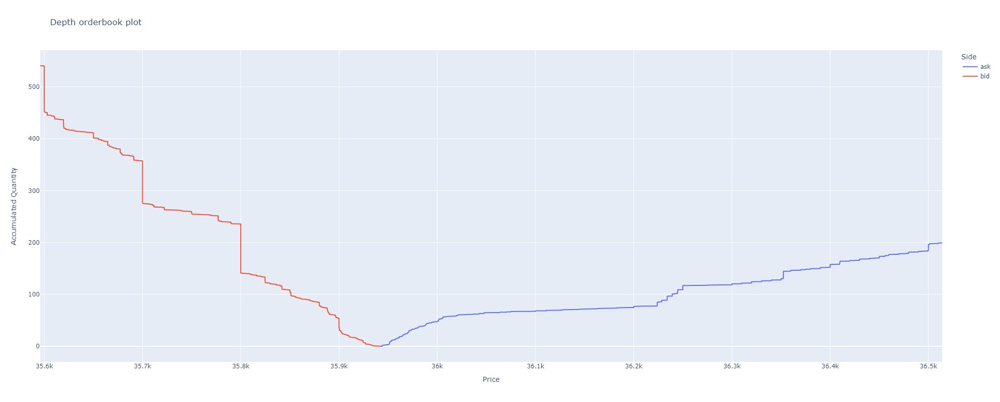

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [51]:
btcusdt.plot_orderbook()

### Also without accumulation of orders

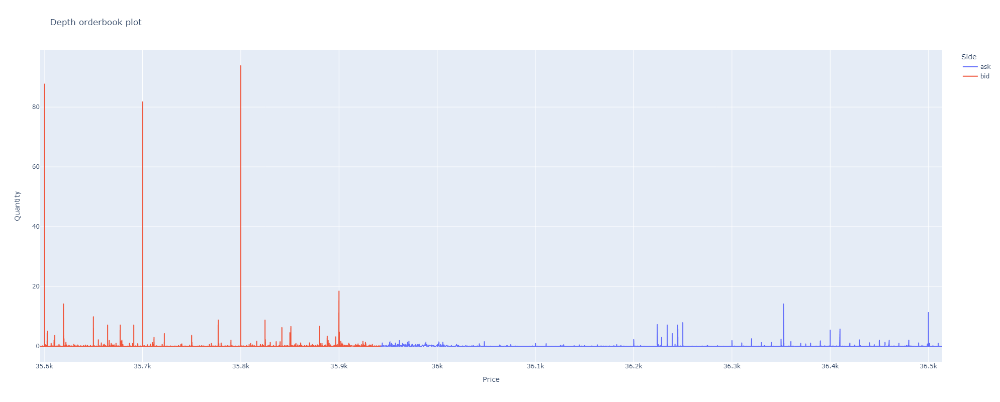

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [52]:
btcusdt.plot_orderbook(accumulated=False)

### A distribution of the orderbook can help

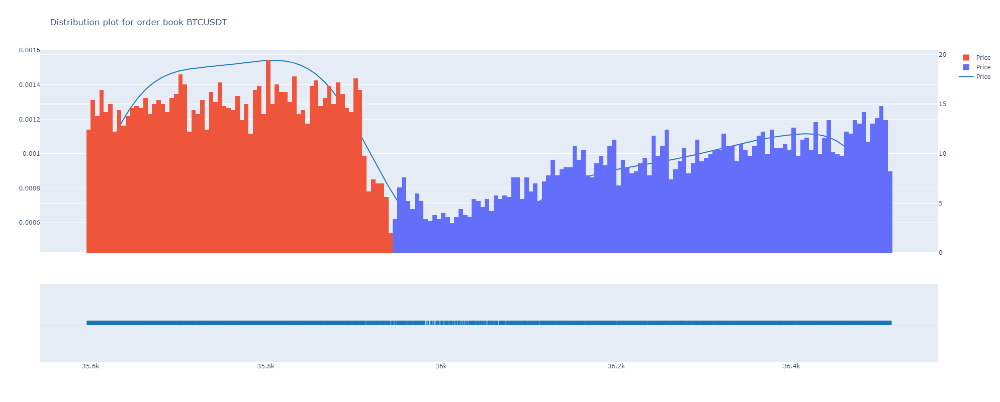

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [53]:
btcusdt.plot_orderbook_density(bins=400)

## Plot market profile
Can be plotted from klines data, but fetching trades (can be slow for big time intervals) shows deeper info.

In [54]:
lunc.df

,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp,SUPERT_10_3.0,SUPERTd_10_3.0,SUPERTl_10_3.0,SUPERTs_10_3.0,Support_Resistance_1,Support_Resistance_2,Support_Resistance_3,Support_Resistance_4,Support_Resistance_5
LUNCBUSD 5m Europe/Madrid,,,,,,,,,,,,,,,,,,,,,,,
2023-11-04 19:15:00+01:00,2023-11-04 19:15:00+01:00,0.000064,0.000064,0.000064,0.000064,9.353851e+06,2023-11-04 19:19:59.999000+01:00,600.972495,8,1.554864e+05,9.977562,0,1699121700000,1699121999999,NaN,1,NaN,NaN,0.000066,0.000073,0.00008,0.000085,0.000092
2023-11-04 19:20:00+01:00,2023-11-04 19:20:00+01:00,0.000064,0.000064,0.000064,0.000064,1.041416e+07,2023-11-04 19:24:59.999000+01:00,667.368590,30,1.921597e+06,123.208112,0,1699122000000,1699122299999,NaN,1,NaN,NaN,0.000066,0.000073,0.00008,0.000085,0.000092
2023-11-04 19:25:00+01:00,2023-11-04 19:25:00+01:00,0.000064,0.000064,0.000064,0.000064,7.724962e+06,2023-11-04 19:29:59.999000+01:00,495.216312,8,6.189672e+05,39.675799,0,1699122300000,1699122599999,NaN,1,NaN,NaN,0.000066,0.000073,0.00008,0.000085,0.000092
2023-11-04 19:30:00+01:00,2023-11-04 19:30:00+01:00,0.000064,0.000064,0.000064,0.000064,8.776003e+06,2023-11-04 19:34:59.999000+01:00,562.705627,7,1.419551e+06,91.130686,0,1699122600000,1699122899999,NaN,1,NaN,NaN,0.000066,0.000073,0.00008,0.000085,0.000092
2023-11-04 19:35:00+01:00,2023-11-04 19:35:00+01:00,0.000064,0.000064,0.000064,0.000064,2.718855e+07,2023-11-04 19:39:59.999000+01:00,1746.443234,40,2.439486e+07,1567.005836,0,1699122900000,1699123199999,NaN,1,NaN,NaN,0.000066,0.000073,0.00008,0.000085,0.000092
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-14 18:45:00+01:00,2023-11-14 18:45:00+01:00,0.000079,0.000079,0.000079,0.000079,3.129216e+07,2023-11-14 18:49:59.999000+01:00,2467.801469,28,2.577065e+07,2032.486071,0,1699983900000,1699984199999,0.000080,-1,NaN,0.000080,0.000066,0.000073,0.00008,0.000085,0.000092
2023-11-14 18:50:00+01:00,2023-11-14 18:50:00+01:00,0.000079,0.000079,0.000079,0.000079,4.648059e+07,2023-11-14 18:54:59.999000+01:00,3656.047386,29,6.719021e+06,528.247810,0,1699984200000,1699984499999,0.000080,-1,NaN,0.000080,0.000066,0.000073,0.00008,0.000085,0.000092
2023-11-14 18:55:00+01:00,2023-11-14 18:55:00+01:00,0.000079,0.000079,0.000078,0.000078,1.459468e+08,2023-11-14 18:59:59.999000+01:00,11458.877489,47,2.165500e+07,1700.398397,0,1699984500000,1699984799999,0.000079,-1,NaN,0.000079,0.000066,0.000073,0.00008,0.000085,0.000092


2023-11-14	 19:12:39     INFO Using klines data. For deeper info add trades data, example: my_symbol.get_agg_trades()
C:\Users\hanca\PycharmProjects\binpan_studio\handlers\plotting.py:1384: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



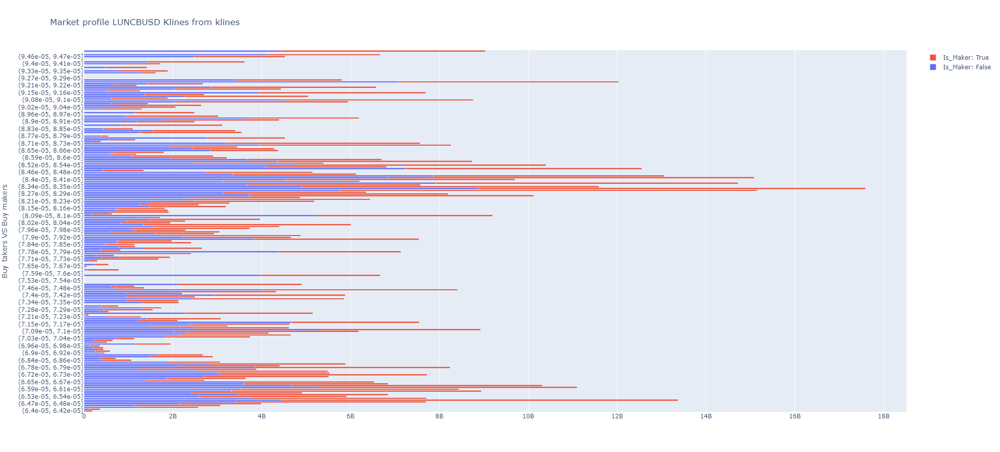

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [55]:
# from klines
lunc.plot_market_profile(bins=200)  

Fetching trades improves the market profile info

In [56]:
# get trades for just last hour
lunc.get_atomic_trades(hours=60)

Requesting atomic trades between 2023-11-12 07:12:39 and 2023-11-14 19:05:00


2023-11-14	 19:12:39     INFO Requests API for atomic trades searching STARTIME LUNCBUSD: 2 current_first_trade:111203404
2023-11-14	 19:12:40     INFO Requests API for atomic trades searching STARTIME LUNCBUSD: 3 current_first_trade:111202404
2023-11-14	 19:12:40     INFO Requests API for atomic trades searching STARTIME LUNCBUSD: 4 current_first_trade:111201404
2023-11-14	 19:12:40     INFO Requests API for atomic trades searching STARTIME LUNCBUSD: 5 current_first_trade:111200404
2023-11-14	 19:12:40     INFO Requests API for atomic trades searching STARTIME LUNCBUSD: 6 current_first_trade:111199404
2023-11-14	 19:12:41     INFO Requests API for atomic trades searching STARTIME LUNCBUSD: 7 current_first_trade:111198404
2023-11-14	 19:12:41     INFO Requests API for atomic trades searching STARTIME LUNCBUSD: 8 current_first_trade:111197404
2023-11-14	 19:12:41     INFO Requests API for atomic trades searching STARTIME LUNCBUSD: 9 current_first_trade:111196404
2023-11-14	 19:12:42    

,Trade Id,Price,Quantity,Quote quantity,Date,Timestamp,Buyer was maker,Best price match
LUNCBUSD Europe/Madrid,,,,,,,,
0,111141899,0.000081,521680.02,42.511705,2023-11-12 07:13:12+01:00,1699769592532,False,True
1,111141900,0.000081,73555.03,5.993999,2023-11-12 07:13:52+01:00,1699769632424,False,True
2,111141901,0.000081,82846.37,6.746180,2023-11-12 07:13:56+01:00,1699769636620,True,True
3,111141902,0.000081,89655.25,7.300627,2023-11-12 07:14:17+01:00,1699769657199,False,True
4,111141903,0.000081,747073.11,60.834163,2023-11-12 07:14:26+01:00,1699769666368,False,True
...,...,...,...,...,...,...,...,...
62330,111204229,0.000079,63565.91,4.996916,2023-11-14 19:04:27+01:00,1699985067484,False,True
62331,111204230,0.000079,523022.58,41.109575,2023-11-14 19:04:36+01:00,1699985076504,True,True
62332,111204231,0.000079,1272426.51,99.999999,2023-11-14 19:04:36+01:00,1699985076508,True,True


C:\Users\hanca\PycharmProjects\binpan_studio\handlers\plotting.py:1384: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



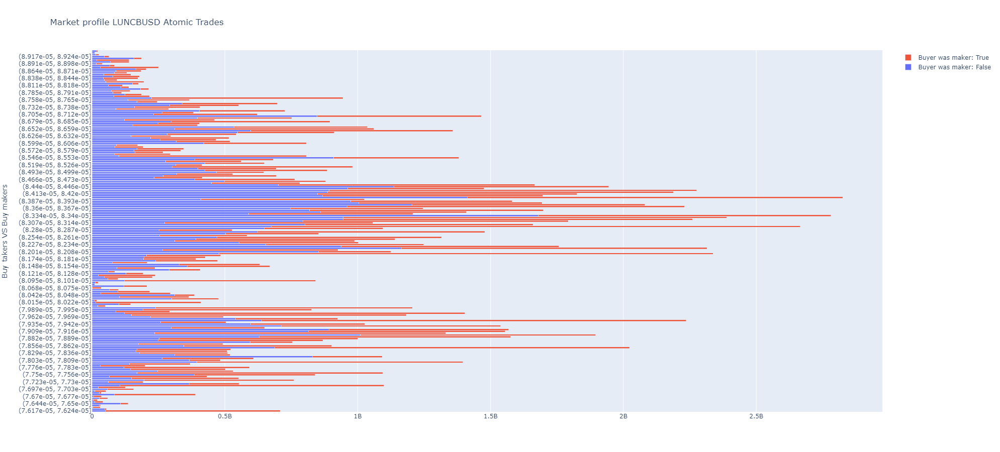

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [57]:
lunc.plot_market_profile(from_atomic_trades=True, bins=200)

# Taker percentage ratios

In [58]:
lunc.get_maker_taker_buy_ratios()

2023-11-14	 19:13:02     INFO Maker vs Taker buy ratio: 6 NaNs found. Converting to zeros.
2023-11-14	 19:13:02     INFO New column: Ratio_Taker/Maker_buy


,Ratio_Taker/Maker_buy,Ratio_Taker/Maker_buy_EMA_14
LUNCBUSD 5m Europe/Madrid,,
2023-11-04 19:15:00+01:00,0.016623,NaN
2023-11-04 19:20:00+01:00,0.184518,NaN
2023-11-04 19:25:00+01:00,0.080126,NaN
2023-11-04 19:30:00+01:00,0.161754,NaN
2023-11-04 19:35:00+01:00,0.897248,NaN
...,...,...
2023-11-14 18:45:00+01:00,0.823550,0.544141
2023-11-14 18:50:00+01:00,0.144555,0.490863
2023-11-14 18:55:00+01:00,0.148376,0.445198


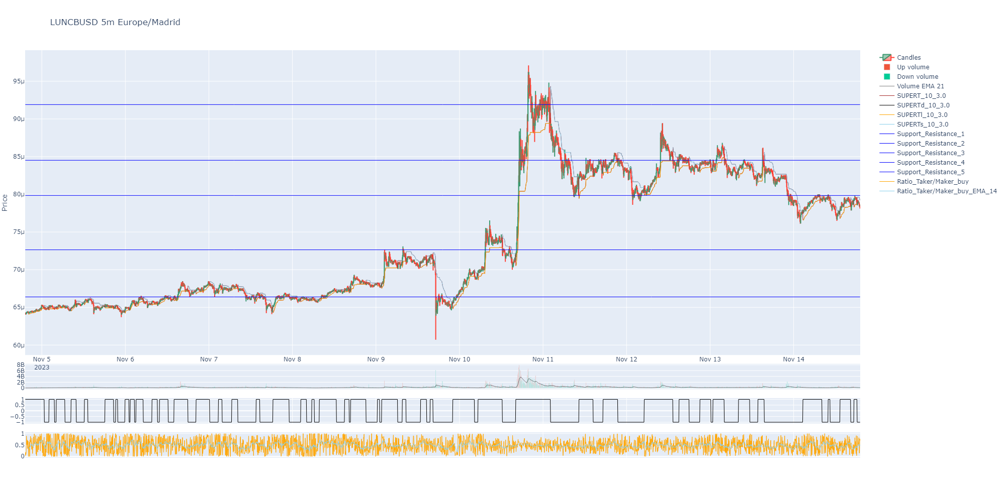

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [59]:
lunc.plot()

# Taker percentage profile

2023-11-14	 19:13:05     INFO Using klines data. For deeper info add trades data, example: my_symbol.get_agg_trades()
C:\Users\hanca\PycharmProjects\binpan_studio\handlers\indicators.py:1080: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



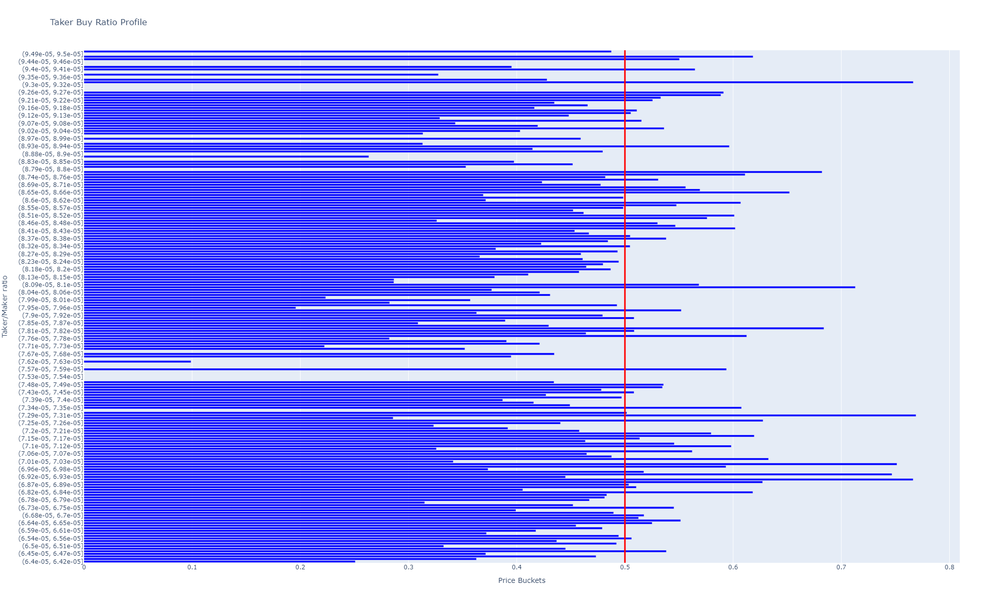

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [60]:
lunc.plot_taker_maker_ratio_profile(bins=200)

# Support resistance levels

2023-11-14	 19:13:05     INFO Updating support_resistance levels for LUNCBUSD from atomic trades
2023-11-14	 19:13:05     INFO Removing plot info for associated columns: ['Support_Resistance_1', 'Support_Resistance_2', 'Support_Resistance_3', 'Support_Resistance_4', 'Support_Resistance_5']
2023-11-14	 19:13:05     INFO Removing plot info for column Support_Resistance_1
2023-11-14	 19:13:05     INFO Removing plot info for column Support_Resistance_2
2023-11-14	 19:13:05     INFO Removing plot info for column Support_Resistance_3
2023-11-14	 19:13:05     INFO Removing plot info for column Support_Resistance_4
2023-11-14	 19:13:05     INFO Removing plot info for column Support_Resistance_5


Clustering data...


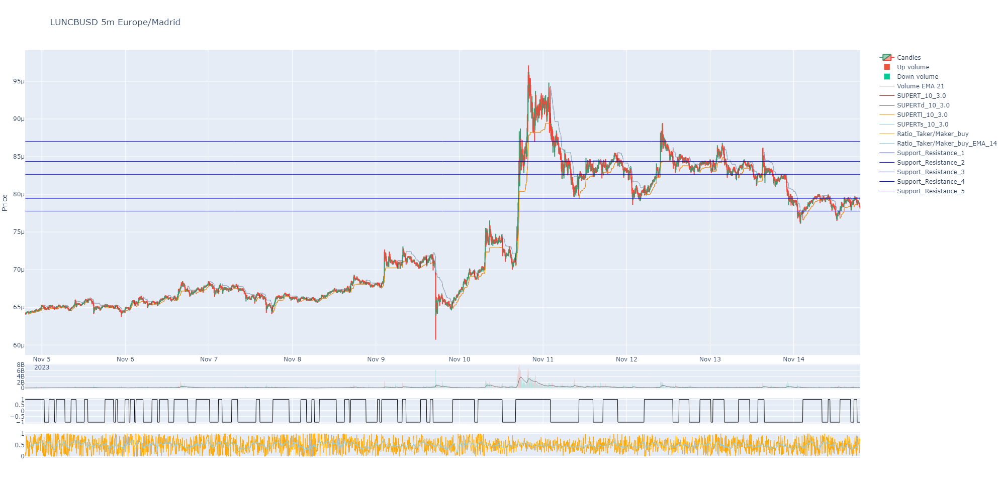

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [61]:
lunc.support_resistance(from_atomic=True, max_clusters=5)
lunc.plot()

# Time action
This are centroids from timestamps to plot time zones with more volume. It can be done from trades for better accuracy.

2023-11-14	 19:13:08     INFO Time centroids added from atomic trades


Clustering data...


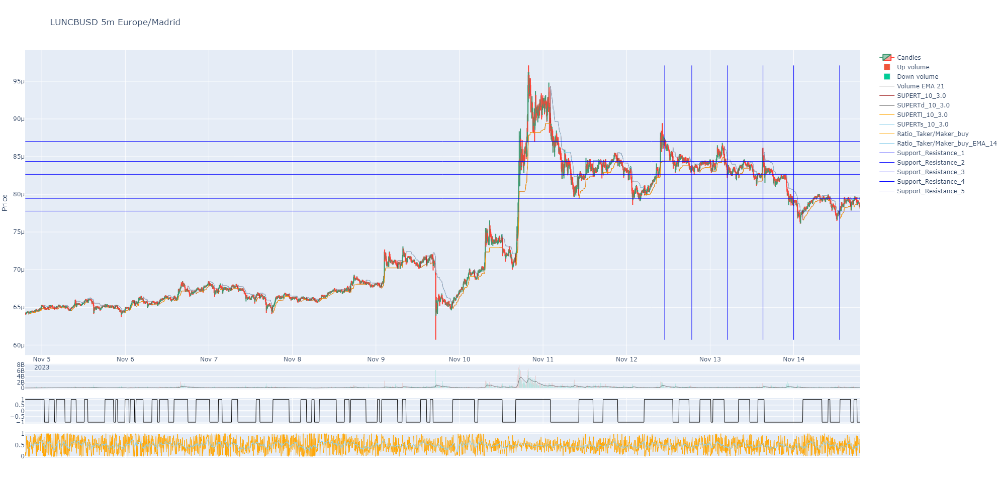

'C:\\Users\\hanca\\PycharmProjects\\binpan_studio\\last_plot.png'

In [62]:
lunc.time_centroids(from_atomic=True, max_clusters=6)
lunc.plot()

# Thank you